# DIRAC characterizes finer structures of the mouse thymus domains

- by CHANG XU changxu@nus.edu.sg.
- Last update: October 4th 2024

## Download the data （Under review, will be provided later）
- if you are have ``wget`` installed, you can run the following code to automatically download and unzip the data.

In [ ]:
# Skip this cells if data are already download
! wget -O A02677B5_bin100_Protein.h5ad "*******"
! wget -O A02677B5_bin100_RNA.h5ad "*******"
! wget -O A02677B5_bin50_Protein.h5ad "*******"
! wget -O A02677B5_bin50_RNA.h5ad "*******"

- if you do not have wget installed, manually download data from the links below:
    - Mouse spleen bin100 is collected from ADT: "**********"
    - Mouse spleen bin100 is from RNA: "***********"
    - Mouse spleen bin50 is collected from ADT: "**********"
    - Mouse spleen bin50 is from RNA: "***********"

## DIRAC's vertical integration of RNA + ADT data at bin100 resolution

In [25]:
########## load packages
import os
import random

import pandas as pd
import numpy as np
import torch
import scanpy as sc
import matplotlib.pyplot as plt

######## load dirac
import sodirac as sd

In [26]:
def seed_torch(seed=1029):   
    random.seed(seed)    
    os.environ['PYTHONHASHSEED'] = str(seed)    
    np.random.seed(seed)    
    torch.manual_seed(seed)    
    torch.cuda.manual_seed(seed)    
    torch.cuda.manual_seed_all(seed) 
    # if you are using multi-GPU.    
    torch.backends.cudnn.benchmark = False    
    torch.backends.cudnn.deterministic = True

seed_torch(seed=88)

In [27]:
######### Define colors for spatial multi-omics domain
colormaps= ["#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", "#F781BF", "#999999", 
"#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5", 
"#BC80BD", "#FFED6F", "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6","#6A3D9A", "#B15928"]

In [28]:
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_bin100"
methods = "Dirac"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))

In [29]:
adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

In [30]:
adata_RNA = adata_RNA.raw.to_adata()
adata_Protein = adata_Protein.raw.to_adata()

In [31]:
common_index = adata_RNA.obs_names.intersection(adata_Protein.obs_names)
adata_RNA = adata_RNA[common_index]
adata_Protein = adata_Protein[common_index]

In [32]:
adata_RNA

View of AnnData object with n_obs × n_vars = 5239 × 26647
    obs: 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [33]:
adata_Protein

View of AnnData object with n_obs × n_vars = 5239 × 128
    obs: 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [34]:
######### Data processing
n_clusters = 4
adata_RNA.obs["Omics"] = data_name + "_mRNA"
adata_RNA.obs['Omics'] = adata_RNA.obs['Omics'].astype('category')
adata_Protein.obs["Omics"] = data_name + "_Protein"
adata_Protein.obs['Omics'] = adata_Protein.obs['Omics'].astype('category')

In [35]:
######### Data processing
sc.pp.filter_genes(adata_RNA, min_cells=3)
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)
sc.pp.scale(adata_RNA)
sc.tl.pca(adata_RNA, n_comps=200)

In [36]:
######### Data processing
sc.pp.normalize_total(adata_Protein, target_sum=1e4)
sc.pp.log1p(adata_Protein)
sc.pp.scale(adata_Protein)

In [37]:
adata_RNA.obsm['spatial'] = adata_RNA.obsm['spatial'].astype('float32')

In [38]:
edge_index = sd.utils.get_single_edge_index(adata_RNA.obsm["spatial"].copy(), n_neighbors = 8, graph_methods = "knn")
print(len(edge_index)/adata_RNA.shape[0])
edge_index = torch.LongTensor(edge_index).T

8.0


In [39]:
y = pd.Categorical(
            np.array(adata_RNA.obs["Omics"]),
            categories=np.unique(adata_RNA.obs["Omics"]),
        ).codes
save_path = os.path.join("/home/users/nus/changxu/scratch/section5/Results", f"{data_name}_{methods}", f"{now}")
if not os.path.exists(save_path):
	os.makedirs(save_path)

In [40]:
###### Training Dirac for spatial multi-omics
dirac = sd.main.integrate_app(save_path = save_path, use_gpu = True, subgraph=True)
samples = dirac._get_data(dataset_list = [adata_RNA.obsm["X_pca"].copy(), adata_Protein.X.copy()],
							batch_list = [y, y],
							domain_list = [np.zeros(adata_RNA.shape[0]), np.ones(adata_Protein.shape[0])],
                            edge_index = edge_index,
							num_parts = 10,
							num_workers = 1,
							batch_size = 1,)
models = dirac._get_model(samples, 
						n_hiddens = 128,
        				n_outputs = 64,
        				opt_GNN = "GCN",) 
data_z, combine_recon, _ = dirac._train_dirac_integrate(samples = samples,
							models = models,
							epochs = 100,
                            lamb = 5e-4, 
                    		scale_loss = 0.5,
                            lr = 1e-3,
                            wd = 5e-2,
    						)

Computing METIS partitioning...
Done!


Found 2 unique domains.


Project..: 100%|█| 100/100 [00:34<00:00,  2.90it/s, Loss=624, Di


Best resolution:  0.08000000000000002
fitting ...
  |======================================================================| 100%


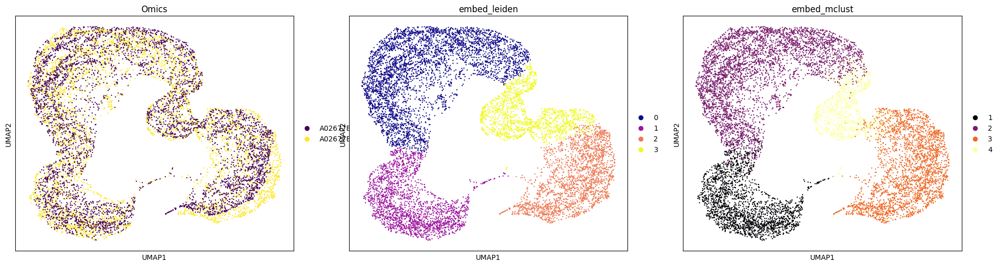

In [41]:
adata_RNA.obsm[f"{methods}_embed"] = data_z[: adata_RNA.shape[0], :]
adata_Protein.obsm[f"{methods}_embed"] = data_z[adata_RNA.shape[0] :, :]
adata_RNA.obsm["combine_recon"] = combine_recon
adata_Protein.obsm["combine_recon"] = combine_recon

adata = anndata.AnnData(data_z)
adata.obs = pd.concat([adata_RNA.obs, adata_Protein.obs])
adata.obsm[f"{methods}_embed"] = data_z
sc.pp.neighbors(adata, use_rep='X')
sc.tl.umap(adata)
res_RNA_ATAC = _priori_cluster(adata, eval_cluster_n = n_clusters)
sc.tl.leiden(adata, resolution = res_RNA_ATAC, key_added="embed_leiden")
mclust_R(adata=adata, num_cluster = n_clusters, used_obsm=f"{methods}_embed", key_added="embed_mclust")

# Set the number and layout of subplots
n_panels = 3
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ['Omics', "embed_leiden", "embed_mclust"]
colormaps = ["viridis", "plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.umap(adata, color=color, palette=cmap, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path with a filename that includes the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_embed_umap_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

# # Close the figure to free up memory
# plt.close(fig)  # Commented section

In [42]:
adata_RNA.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_mRNA"]
adata_Protein.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_Protein"]
adata_RNA.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_mRNA"]
adata_Protein.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_Protein"]

Best resolution:  0.07
fitting ...
  |======================================================================| 100%


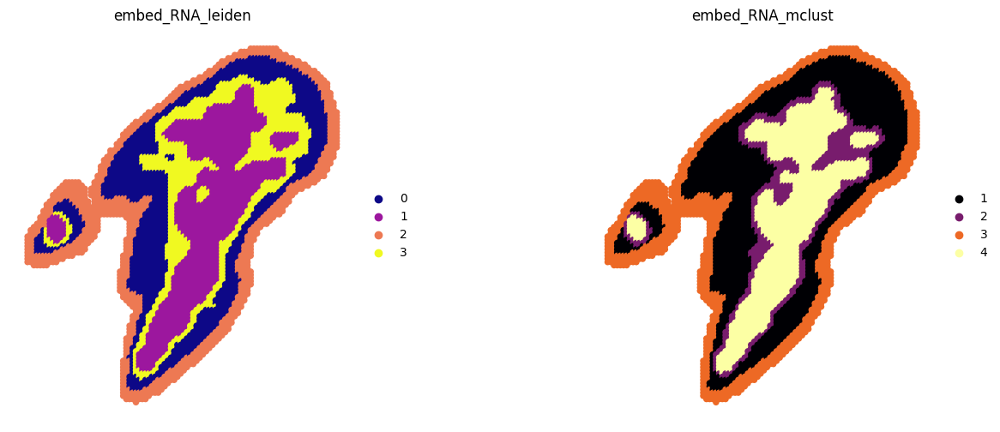

In [43]:
####### RNA
sc.pp.neighbors(adata_RNA, use_rep=f"{methods}_embed")
res_RNA_ATAC = _priori_cluster(adata_RNA, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_RNA, resolution=res_RNA_ATAC, key_added="embed_RNA_leiden")
mclust_R(adata=adata_RNA, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_RNA_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["embed_RNA_leiden", "embed_RNA_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=200, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path with a filename that includes the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_RNA_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

Best resolution:  0.07
fitting ...
  |======================================================================| 100%


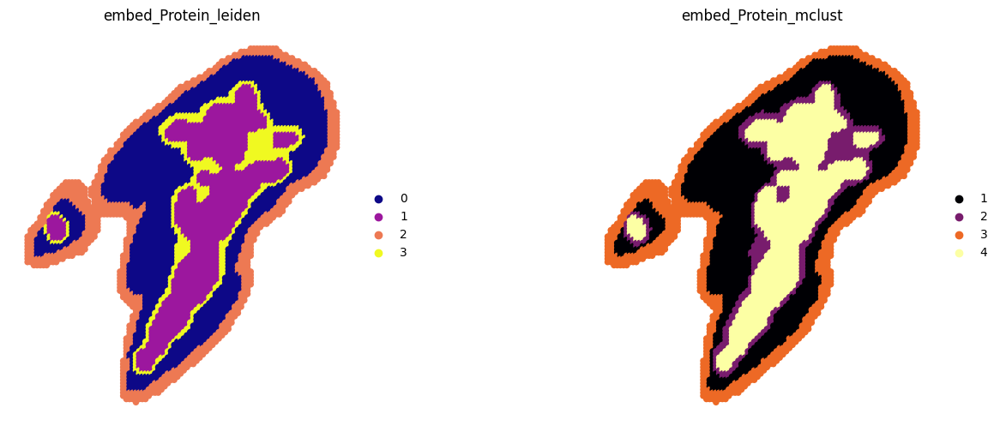

In [44]:
###### Protein
sc.pp.neighbors(adata_Protein, use_rep=f"{methods}_embed")
res_RNA_ATAC = _priori_cluster(adata_Protein, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_Protein, resolution=res_RNA_ATAC, key_added="embed_Protein_leiden")
mclust_R(adata=adata_Protein, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_Protein_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["embed_Protein_leiden", "embed_Protein_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_Protein, color=color, palette=cmap, frameon=False, spot_size=200, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path with a filename that includes the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_Protein_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

Best resolution:  0.05
fitting ...
  |======================================================================| 100%


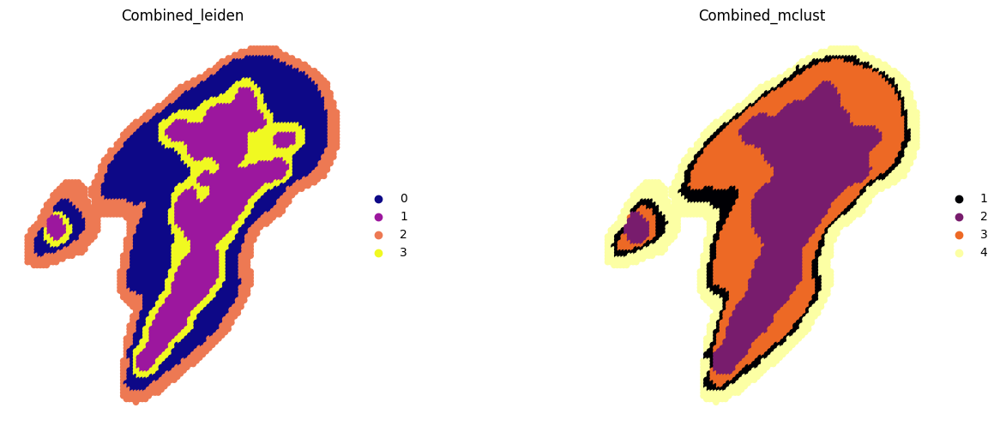

In [45]:
####### Combined
sc.pp.neighbors(adata_RNA, use_rep='combine_recon')
res_RNA_ATAC = _priori_cluster(adata_RNA, eval_cluster_n=n_clusters)
sc.tl.louvain(adata_RNA, resolution=res_RNA_ATAC, key_added="Combined_leiden")
mclust_R(adata=adata_RNA, num_cluster=n_clusters, used_obsm="combine_recon", key_added="Combined_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["Combined_leiden", "Combined_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=200, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path with a filename that includes the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_Combined_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

In [46]:
####### Save Data
adata.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_Protein_{now}.h5ad"),compression="gzip")
adata_RNA.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_{now}.h5ad"),compression="gzip")
adata_Protein.write(os.path.join(save_path,f"{data_name}_{methods}_Protein_{now}.h5ad"),compression="gzip")

In [47]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826'

##  Determine partition identity and validation

In [145]:
save_path = "/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826"
adata_RNA = sc.read(os.path.join(save_path, "A02677B5_bin100_Dirac_RNA_20240923144826.h5ad"))
adata_Protein = sc.read(os.path.join(save_path, "A02677B5_bin100_Dirac_Protein_20240923144826.h5ad"))

In [146]:
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_bin100"
methods = "Dirac"
adata_RNA_raw = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))

In [147]:
adata_RNA.uns['Combined_leiden_colors']

array(['#0d0887', '#9c179e', '#ed7953', '#f0f921'], dtype=object)

In [148]:
adata_RNA_raw

AnnData object with n_obs × n_vars = 5274 × 26647
    obs: 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [149]:
adata_RNA_raw = adata_RNA_raw[adata_RNA.obs_names,:]

In [150]:
adata_RNA_raw.obs = adata_RNA.obs

In [151]:
adata_RNA_raw.uns["Combined_leiden_colors"] = adata_RNA.uns["Combined_leiden_colors"]
adata_RNA_raw.obsm['combine_recon'] = adata_RNA.obsm['combine_recon']

genes_to_remove = [gene for gene in adata_RNA_raw.var_names if gene.startswith("Gm") or gene.startswith("Mt")]

# Print the number of genes to be removed for inspection
print(f"Removing {len(genes_to_remove)} genes that start with 'Gm' or 'Mt'")

# Remove these genes
adata_RNA_raw = adata_RNA_raw[:, ~adata_RNA_raw.var_names.isin(genes_to_remove)]

Removing 5404 genes that start with 'Gm' or 'Mt'


In [81]:
sc.pp.normalize_total(adata_RNA_raw, target_sum=1e4)
sc.pp.log1p(adata_RNA_raw)
adata_RNA_raw.raw = adata_RNA_raw.copy()
sc.pp.highly_variable_genes(adata_RNA_raw, flavor="seurat_v3_paper", n_top_genes=3000, subset=True)
sc.tl.rank_genes_groups(adata_RNA_raw, groupby="Combined_leiden", method="wilcoxon") #, use_raw=False

In [82]:
adata_RNA_raw.uns["rank_genes_groups"]

{'params': {'groupby': 'Combined_leiden',
  'reference': 'rest',
  'method': 'wilcoxon',
  'use_raw': True,
  'layer': None,
  'corr_method': 'benjamini-hochberg'},
 'names': rec.array([('Rag1', 'H2-K1', 'Rpl34', 'Hexb'),
            ('Rmnd5a', 'B2m', 'mt-Nd1', 'Cmss1'),
            ('Trp53inp1', 'Ccnd2', 'Tmem56', 'Selenop'), ...,
            ('Ccnd2', 'Dntt', 'Hexb', 'mt-Nd2'),
            ('B2m', 'Tcf7', 'Inpp4b', 'mt-Cytb'),
            ('H2-K1', 'Rag1', 'Rps9', 'Rpl34')],
           dtype=[('0', 'O'), ('1', 'O'), ('2', 'O'), ('3', 'O')]),
 'scores': rec.array([( 44.827316,  53.33575 ,  25.535007,  15.625362 ),
            ( 34.549488,  49.875572,  20.040615,  14.876641 ),
            ( 34.53311 ,  48.88195 ,  19.807293,  13.84803  ), ...,
            (-28.547544, -44.705635, -28.621702, -10.920881 ),
            (-31.015482, -46.555637, -28.72966 , -10.9669895),
            (-32.261547, -49.10115 , -30.218855, -11.617791 )],
           dtype=[('0', '<f4'), ('1', '<f4'), ('2', '<f4

In [83]:
result = adata_RNA_raw.uns["rank_genes_groups"]
groups = result["names"].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals','pvals_adj','logfoldchanges']}).to_csv(os.path.join(save_path, f'{data_name}_{methods}_markerGenes.csv'))

In [84]:
save_path

'/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826'

         Falling back to preprocessing with `sc.pp.pca` and default params.


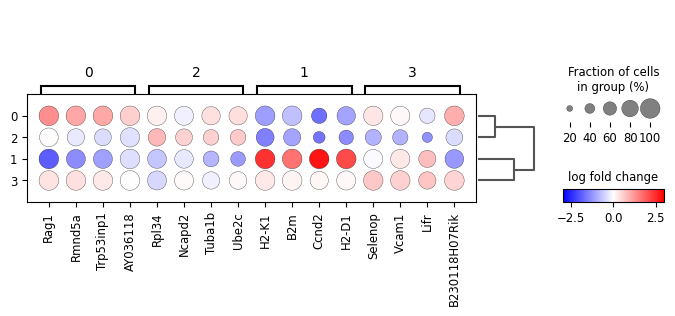

In [85]:
sc.pl.rank_genes_groups_dotplot(
    adata_RNA_raw,
    n_genes=4,
    values_to_plot="logfoldchanges",
    min_logfoldchange=0.5,
    vmax=3,
    vmin=-3,
    cmap="bwr",
)

         Falling back to preprocessing with `sc.pp.pca` and default params.


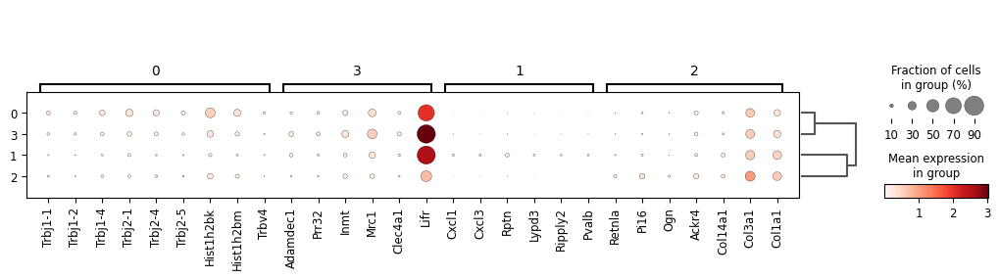

In [152]:
sc.pp.normalize_total(adata_RNA_raw, target_sum=1e4)
sc.pp.log1p(adata_RNA_raw)
marker_genes_dict = {
    "0": ["Trbj1-1", "Trbj1-2", "Trbj1-4", "Trbj2-1","Trbj2-4","Trbj2-5","Hist1h2bk","Hist1h2bm", "Trbv4"],
    "1": ["Cxcl1", "Cxcl3", "Rptn", "Lypd3", "Ripply2", "Pvalb"],
    "2": ["Retnla", "Pi16", "Ogn", "Ackr4", "Col14a1", "Col3a1", "Col1a1"],
    "3": ["Adamdec1", "Prr32", "Inmt", "Mrc1", "Clec4a1","Lifr"],
}

sc.pl.dotplot(adata_RNA_raw, marker_genes_dict, "Combined_leiden", dendrogram=True)

In [86]:
adata_Protein_raw = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))
adata_Protein_raw = adata_Protein_raw[adata_Protein.obs_names,:]
adata_Protein_raw.obs = adata_Protein.obs
adata_Protein_raw.obs['Combined_leiden'] = adata_RNA.obs['Combined_leiden']
adata_Protein_raw.uns["Combined_leiden_colors"] = adata_RNA.uns["Combined_leiden_colors"]
adata_Protein_raw.obsm['combine_recon'] = adata_RNA.obsm['combine_recon']
adata_Protein_raw.X = adata_Protein_raw.X.toarray()
adata_Protein_raw.var_names = [s.replace('_Ms', '') for s in adata_Protein_raw.var_names]

         Falling back to preprocessing with `sc.pp.pca` and default params.


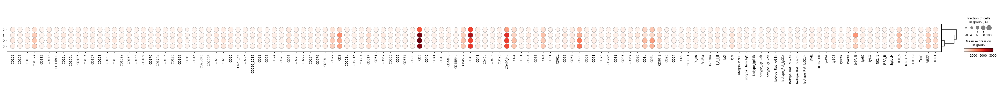

In [87]:
sc.pl.dotplot(adata_Protein_raw, var_names = adata_Protein_raw.var_names.tolist(), 
              groupby='Combined_leiden', dendrogram=True, use_raw=False)

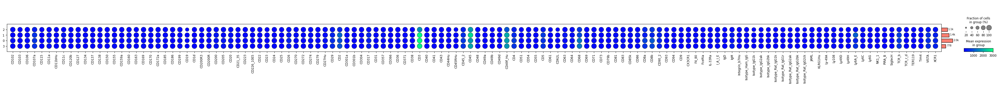

In [88]:
dp = sc.pl.dotplot(adata_Protein_raw, adata_Protein_raw.var_names.tolist(), 
                   'Combined_leiden', return_fig=True, dendrogram=True, use_raw=False)
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

[<Axes: title={'center': 'CD102'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD103'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD106'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD107a'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD115'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD11a'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD11bHu'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD11c'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD120b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD127'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD134'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD137'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD138'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD150'},

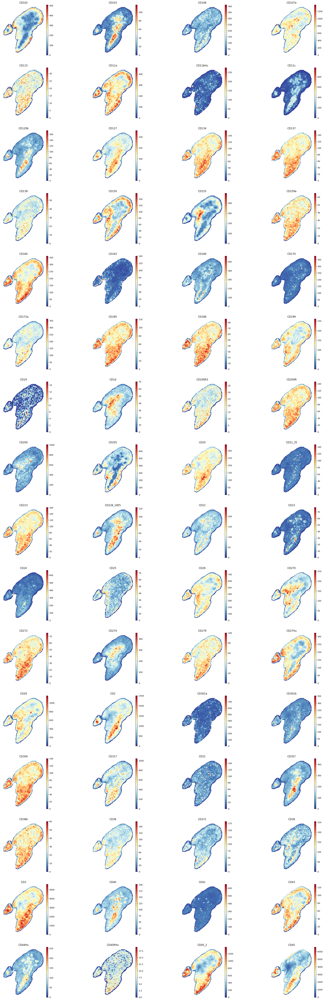

In [89]:
sc.pl.spatial(adata_Protein_raw, color=adata_Protein_raw.var_names.tolist()[:64], 
              frameon=False, spot_size=200, show=False, use_raw=False, cmap="RdYlBu_r") ### RdYlBu_r, CMRmap_r

[<Axes: title={'center': 'CD48'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD49a'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD49b'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD49d'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD49f_Hu'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD4'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD51'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD54'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD55'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD5'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD61'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD62L'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD63'}, xlabel='spatial1', ylabel='spatial2'>,
 <Axes: title={'center': 'CD64'}, xlabel='spa

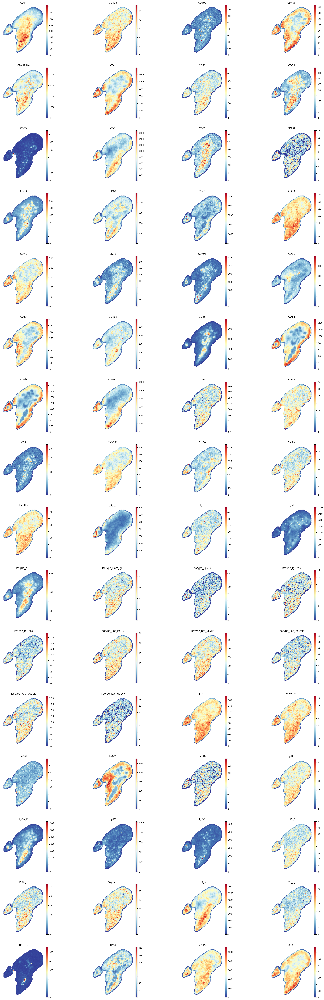

In [90]:
sc.pl.spatial(adata_Protein_raw, color=adata_Protein_raw.var_names.tolist()[64:], 
              frameon=False, spot_size=200, show=False, use_raw=False, cmap="RdYlBu_r") ### RdYlBu_r, CMRmap_r

In [115]:
marker_protein = {
    "0": ['CD150', 'CD160',  'CD4', 'CD49d', 'Ly108', 'XCR1'],
    "1": ['CD11c', 'CD103', 'CD86', 'CD357','CD226_10E5', 'CD73', 'CD2', 'CD127','CD61', ],
    "2": ["CD25", 'CD71','CD137', 'CD185', 'CD186'],
    "3": ['CD64'],
    # "4": ["CD357", "CD63", 'CD86',"Ly6A_E",],
}
sc.pp.normalize_total(adata_Protein_raw, target_sum=1e4)
sc.pp.log1p(adata_Protein_raw)
sc.pp.scale(adata_Protein_raw)

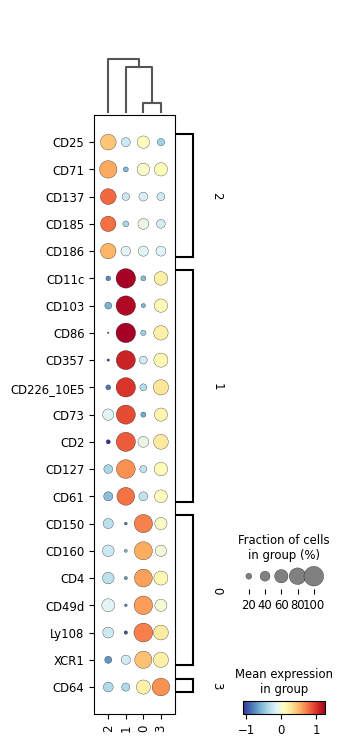

<Figure size 640x480 with 0 Axes>

In [139]:
sc.pl.dotplot(adata_Protein_raw, marker_protein, 'Combined_leiden', dendrogram=True, use_raw=False, cmap="RdYlBu_r", swap_axes=True)
plt.savefig(os.path.join(save_path, f"{data_name}_{methods}_protein_heatmaps.pdf"))

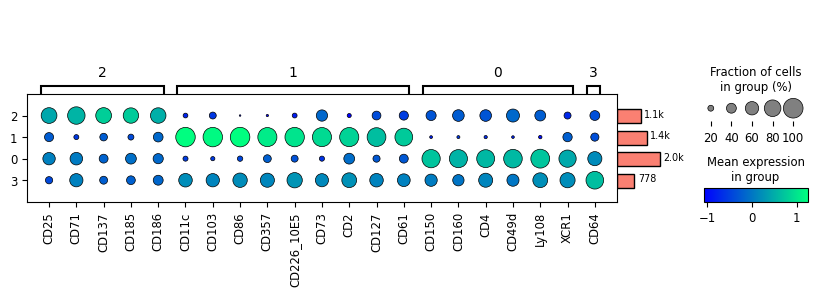

In [117]:
dp = sc.pl.dotplot(adata_Protein_raw, marker_protein,
                   'Combined_leiden', return_fig=True, dendrogram=True, use_raw=False, cmap="RdYlBu_r")
dp.add_totals().style(dot_edge_color='black', dot_edge_lw=0.5).show()

[<Axes: title={'center': 'region domain'}, xlabel='spatial1', ylabel='spatial2'>]

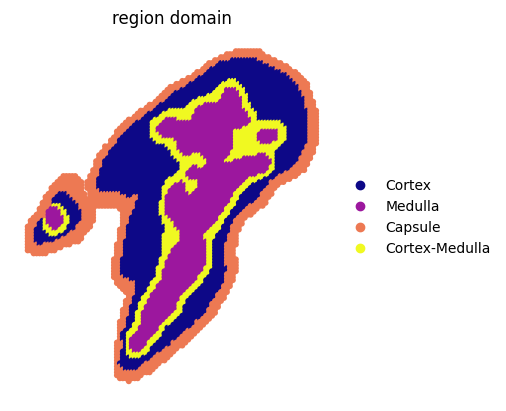

In [120]:
# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "0": "Cortex",
    "1": "Medulla",
    "2": "Capsule",
    "3": "Cortex-Medulla",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_RNA.obs["region domain"] = adata_RNA.obs['Combined_leiden'].map(cluster2annotation).astype("category")

# sc.pl.spatial(adata_RNA, color=["region domain"], palette=adata_RNA.uns["Combined_leiden_colors"], frameon=False, spot_size=200, show=False)

########### save colors
cluster2colors = {
    "Cortex": '#0d0887',
    "Medulla": '#9c179e',
    "Capsule": '#ed7953',
    "Cortex-Medulla":'#f0f921',
}
sc.pl.spatial(adata_RNA, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=200, show=False)

In [122]:
import spateo as st

2024-09-23 15:44:01.886698: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-23 15:44:02.006070: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-23 15:44:02.016476: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1452] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-23 15:44:04.661089: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT


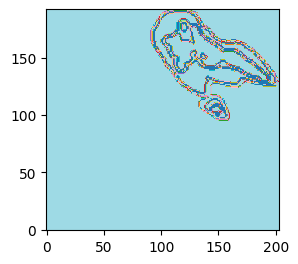

In [123]:
adata_RNA.uns["__type"] = 'UMI'
st.pl.spatial_domains(adata_RNA, bin_size=100, label_key="region domain", save_img=os.path.join(save_path, "spatial_domains.png"))

In [124]:
import spateo as st

adata_RNA.obsm['spatial_bin100'] = adata_RNA.obsm['spatial']//100

# Load spatial domain image as background
# adata_celltype = sc.read("")


adata_RNA = st.io.read_image(
    adata_RNA,
    filename=os.path.join(save_path, "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

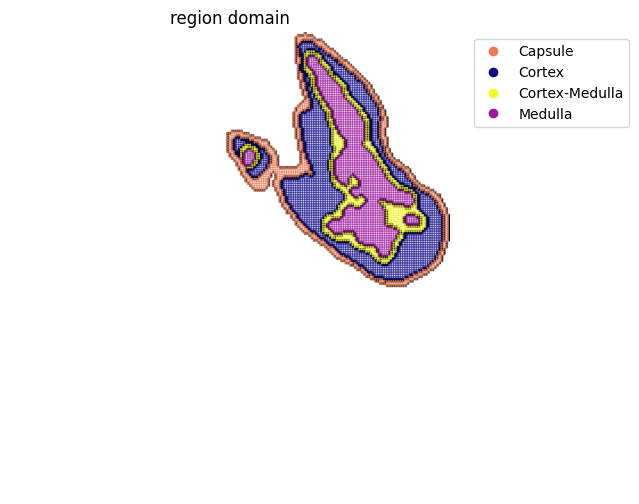

<Figure size 640x480 with 0 Axes>

In [126]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA,
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.8,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.05,
    color_key = cluster2colors,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains.pdf"))

In [130]:
adata_RNA.uns.keys()

dict_keys(['Combined_leiden', 'Combined_leiden_colors', 'Combined_mclust_colors', 'bin_size', 'bin_type', 'embed_RNA_leiden', 'embed_RNA_leiden_colors', 'embed_RNA_mclust_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'resolution', 'sn', 'region domain_colors', '__type', 'spatial'])

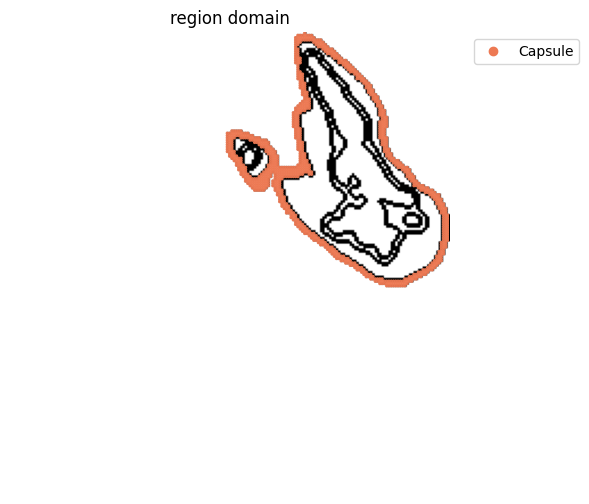

<Figure size 640x480 with 0 Axes>

In [133]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin(["Capsule"]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Capsule.png"))

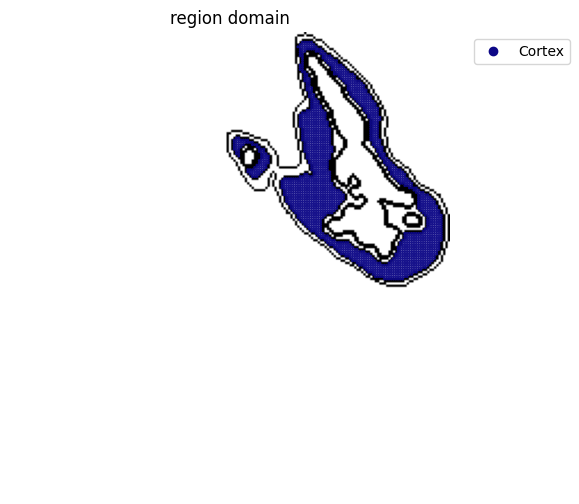

<Figure size 640x480 with 0 Axes>

In [134]:
sub_regions = "Cortex"
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin([sub_regions]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_{sub_regions}.png"))

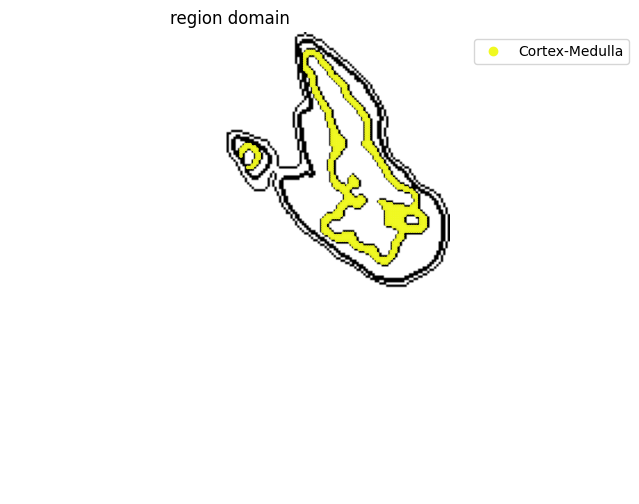

<Figure size 640x480 with 0 Axes>

In [135]:
sub_regions = "Cortex-Medulla"
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin([sub_regions]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_{sub_regions}.png"))

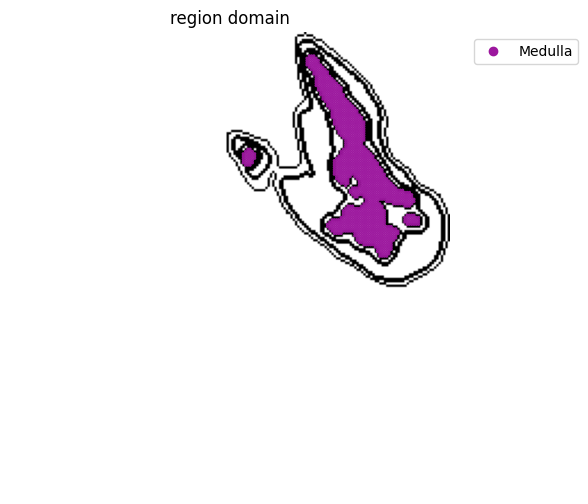

<Figure size 640x480 with 0 Axes>

In [136]:
sub_regions = "Medulla"
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA[adata_RNA.obs["region domain"].isin([sub_regions]), :],
    space="spatial_bin100",
    color=["region domain"],
    alpha=0.95,
    pointsize=0.05,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA.uns['region domain_colors'],
    ax = ax
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_{sub_regions}.png"))

In [137]:
adata_RNA

AnnData object with n_obs × n_vars = 5239 × 24116
    obs: 'orig.ident', 'x', 'y', 'Omics', 'embed_leiden', 'embed_mclust', 'leiden', 'embed_RNA_leiden', 'embed_RNA_mclust', 'Combined_leiden', 'Combined_mclust', 'region domain'
    var: 'n_cells', 'mean', 'std'
    uns: 'Combined_leiden', 'Combined_leiden_colors', 'Combined_mclust_colors', 'bin_size', 'bin_type', 'embed_RNA_leiden', 'embed_RNA_leiden_colors', 'embed_RNA_mclust_colors', 'leiden', 'log1p', 'neighbors', 'pca', 'resolution', 'sn', 'region domain_colors', '__type', 'spatial'
    obsm: 'Dirac_embed', 'X_pca', 'combine_recon', 'spatial', 'spatial_bin100', 'X_spatial_bin100'
    varm: 'PCs'
    obsp: 'connectivities', 'distances'

[<Axes: title={'center': 'region domain'}, xlabel='spatial1', ylabel='spatial2'>]

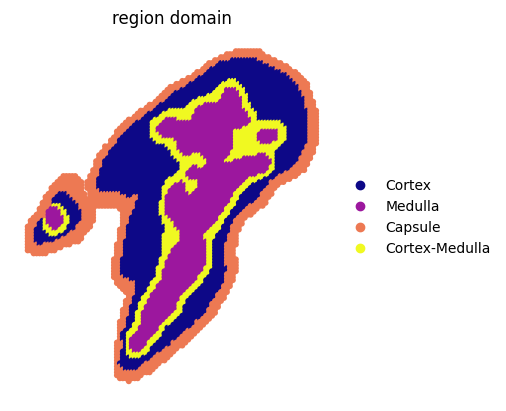

In [8]:
save_path = "/home/users/nus/changxu/scratch/section5/Results/A02677B5_bin100_Dirac/20240923144826"
data_name = "A02677B5_bin100"
methods="Dirac"


adata_bin100 = sc.read(os.path.join(save_path, f"{data_name}_{methods}_RNA_20240923144826.h5ad"))

# create a dictionary to map cluster to annotation label
cluster2annotation = {
    "0": "Cortex",
    "1": "Medulla",
    "2": "Capsule",
    "3": "Cortex-Medulla",
}

# add a new `.obs` column called `cell type` by mapping clusters to annotation using pandas `map` function
adata_bin100.obs["region domain"] = adata_bin100.obs['Combined_leiden'].map(cluster2annotation).astype("category")

########### save colors
cluster2colors = {
    "Cortex": '#0d0887',
    "Medulla": '#9c179e',
    "Capsule": '#ed7953',
    "Cortex-Medulla":'#f0f921',
}

sc.pl.spatial(adata_bin100, color=["region domain"], palette=cluster2colors, frameon=False, spot_size=200, show=False)

# st.utils.cluster_bins_to_cellbins(adata_bin100, adata_cellbin, 'Combined_leiden')
# adata_cellbin.cells["Combined_leiden_from_bin100"] = adata_cellbin.cells["Combined_leiden_from_bins"]

In [6]:
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_bin100"
methods = "Dirac"
adata_RNA_raw = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_RNA_raw = adata_RNA_raw[adata_RNA.obs_names,:]
adata_RNA_raw.obs = adata_RNA.obs

genes_to_remove = [gene for gene in adata_RNA_raw.var_names if gene.startswith("Gm") or gene.startswith("Mt")]

print(f"Removing {len(genes_to_remove)} genes that start with 'Gm' or 'Mt'")

adata_RNA_raw = adata_RNA_raw[:, ~adata_RNA_raw.var_names.isin(genes_to_remove)]

Removing 5404 genes that start with 'Gm' or 'Mt'


In [7]:
sc.pp.normalize_total(adata_RNA_raw, target_sum=1e4)
sc.pp.log1p(adata_RNA_raw)
adata_RNA_raw.raw = adata_RNA_raw.copy()
sc.pp.highly_variable_genes(adata_RNA_raw, flavor="seurat_v3_paper", n_top_genes=3000, subset=True)
sc.tl.rank_genes_groups(adata_RNA_raw, groupby="region domain", method="wilcoxon") #, use_raw=False

result = adata_RNA_raw.uns["rank_genes_groups"]
groups = result["names"].dtype.names
pd.DataFrame(
    {group + '_' + key: result[key][group]
    for group in groups for key in ['names', 'pvals','pvals_adj','logfoldchanges']}).to_csv(os.path.join(save_path, f'{data_name}_{methods}_markerGenes.csv'))

         Falling back to preprocessing with `sc.pp.pca` and default params.


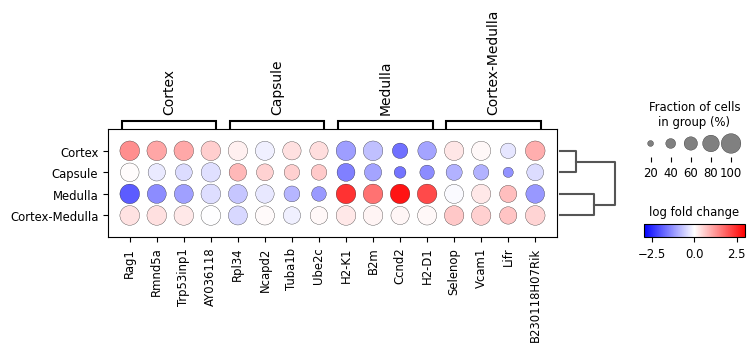

In [8]:
sc.pl.rank_genes_groups_dotplot(
    adata_RNA_raw,
    n_genes=4,
    values_to_plot="logfoldchanges",
    min_logfoldchange=0.5,
    vmax=3,
    vmin=-3,
    cmap="bwr",
)

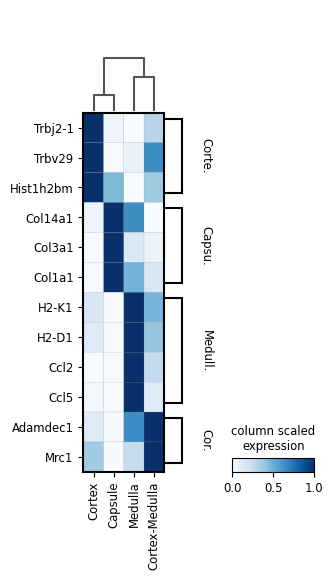

In [27]:
marker_genes_dict = {"Capsule":["Col14a1","Col3a1", "Col1a1"],
               "Cortex":["Trbj2-1", "Trbv29", "Hist1h2bm"],
               "Cortex-Medulla":["Adamdec1", "Mrc1"],
               "Medulla":["H2-K1", "H2-D1", "Ccl2", "Ccl5"], 
               }

sc.pl.matrixplot(
    adata_RNA_raw,
    marker_genes_dict,
    "region domain",
    dendrogram=True,
    cmap="Blues",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
    show=False,
    swap_axes= True,
)
plt.savefig(os.path.join(save_path, f"{data_name}_{methods}_marker_genes_matrixplot.pdf"), dpi=300)

In [35]:
adata_Protein_raw = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))
adata_Protein_raw = adata_Protein_raw[adata_Protein.obs_names,:]
adata_Protein_raw.obs = adata_Protein.obs
adata_Protein_raw.X = adata_Protein_raw.X.toarray()
adata_Protein_raw.var_names = [s.replace('_Ms', '') for s in adata_Protein_raw.var_names]

adata_Protein_raw.obs["region domain"] = adata_RNA.obs["region domain"]
adata_Protein_raw = adata_Protein_raw[adata_Protein_raw.obs['region domain'].isin(["Cortex","Cortex-Medulla","Medulla"])]
sc.pp.normalize_total(adata_Protein_raw, target_sum=1e4)
sc.pp.log1p(adata_Protein_raw)
sc.tl.rank_genes_groups(adata_Protein_raw, groupby="region domain", method="wilcoxon") #, use_raw=False

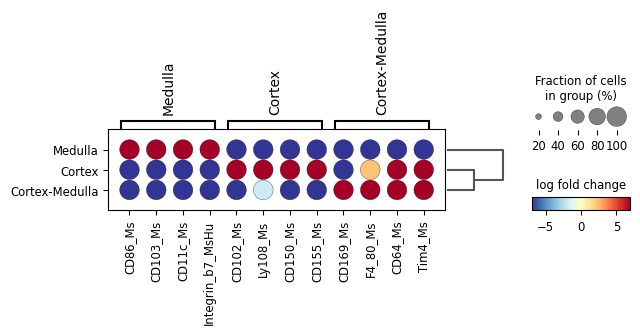

In [41]:
sc.pl.rank_genes_groups_dotplot(
    adata_Protein_raw,
    n_genes=4,
    values_to_plot="logfoldchanges",
    min_logfoldchange=0.5,
    vmax=7,
    vmin=-7,
    cmap="RdYlBu_r",
)

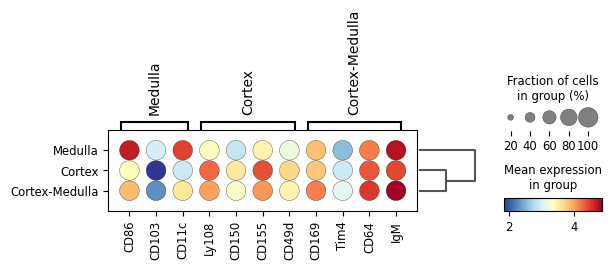

In [39]:
marker_proteins_dict = {
    "Cortex": ['Ly108', 'CD150', 'CD155', 'CD49d'],
    "Cortex-Medulla": ["CD169", 'Tim4','CD64', 'IgM'],
    "Medulla": ['CD86', 'CD103', 'CD11c'],
}

sc.pl.dotplot(adata_Protein_raw, marker_proteins_dict, "region domain", dendrogram=True, use_raw=False, cmap="RdYlBu_r", swap_axes=False)
# plt.savefig(os.path.join(save_path, f"{data_name}_{methods}_protein_heatmaps.pdf"))

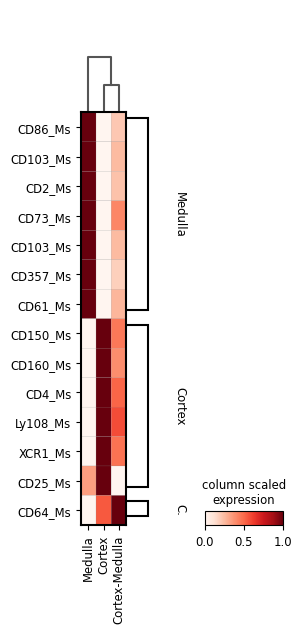

In [52]:
marker_proteins_dict = {
               "Cortex":["CD150_Ms", "CD160_Ms", "CD4_Ms", "Ly108_Ms", "XCR1_Ms", "CD25_Ms",],
               "Cortex-Medulla":["CD64_Ms"],
               "Medulla":["CD86_Ms", "CD103_Ms", "CD2_Ms",  "CD73_Ms", "CD103_Ms", "CD357_Ms", "CD61_Ms"], 
               }

sc.pl.matrixplot(
    adata_Protein_raw,
    marker_proteins_dict,
    "region domain",
    dendrogram=True,
    cmap="Reds",
    standard_scale="var",
    colorbar_title="column scaled\nexpression",
    show=False,
    swap_axes= True,
)
plt.savefig(os.path.join(save_path, f"{data_name}_{methods}_marker_proteins_matrixplot.pdf"), dpi=300)

In [51]:
save_path

'/home/project/11003054/changxu/Projects/SpaGNNs/Review/Re_2024_10_29/section5/Results/A02677B5_bin100_Dirac/20240923144826'

## DIRAC's vertical integration of RNA + ADT data (bin50)

In [ ]:
data_path = "/home/project/11003054/changxu/Data/Stereo_cite_seq"
data_name = "A02677B5_bin50"
methods = "Dirac"
now = time.strftime("%Y%m%d%H%M%S", time.localtime(time.time()))

In [ ]:
adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

In [ ]:
adata_RNA = sc.read(os.path.join(data_path, f"{data_name}_RNA.h5ad"))
adata_Protein = sc.read(os.path.join(data_path, f"{data_name}_Protein.h5ad"))

In [ ]:
common_index = adata_RNA.obs_names.intersection(adata_Protein.obs_names)
adata_RNA = adata_RNA[common_index]
adata_Protein = adata_Protein[common_index]

In [ ]:
adata_RNA

View of AnnData object with n_obs × n_vars = 20494 × 26647
    obs: 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [ ]:
adata_Protein

View of AnnData object with n_obs × n_vars = 20494 × 128
    obs: 'orig.ident', 'x', 'y'
    uns: 'bin_size', 'bin_type', 'resolution', 'sn'
    obsm: 'spatial'

In [ ]:
######### Data processing
n_clusters = 10
adata_RNA.obs["Omics"] = data_name + "_mRNA"
adata_RNA.obs['Omics'] = adata_RNA.obs['Omics'].astype('category')
adata_Protein.obs["Omics"] = data_name + "_Protein"
adata_Protein.obs['Omics'] = adata_Protein.obs['Omics'].astype('category')

In [ ]:
######### Data processing
sc.pp.filter_genes(adata_RNA, min_cells=3)
sc.pp.normalize_total(adata_RNA, target_sum=1e4)
sc.pp.log1p(adata_RNA)
sc.pp.scale(adata_RNA)
sc.tl.pca(adata_RNA, n_comps=200)

In [ ]:
######### Data processing
sc.pp.normalize_total(adata_Protein, target_sum=1e4)
sc.pp.log1p(adata_Protein)
sc.pp.scale(adata_Protein)

In [ ]:
adata_RNA.obsm['spatial'] = adata_RNA.obsm['spatial'].astype('float32')

In [ ]:
######### Construct Graph
edge_index = sd.utils.get_single_edge_index(adata_RNA.obsm["spatial"].copy(), n_neighbors = 12, graph_methods = "knn")
print(len(edge_index)/adata_RNA.shape[0])
edge_index = torch.LongTensor(edge_index).T

12.0


In [ ]:
y = pd.Categorical(
            np.array(adata_RNA.obs["Omics"]),
            categories=np.unique(adata_RNA.obs["Omics"]),
        ).codes
save_path = os.path.join("/home/project/11003054/changxu/Projects/SpaGNNs/Final_code/Results", f"{data_name}_{methods}", f"{now}")
if not os.path.exists(save_path):
	os.makedirs(save_path)

In [ ]:
###### Training Dirac for spatial multi-omics
unsuper = sd.main.integrate_app(save_path = save_path, use_gpu = True, subgraph=True)
samples = unsuper._get_data(dataset_list = [adata_RNA.obsm["X_pca"].copy(), adata_Protein.X.copy()],
							batch_list = [y, y],
							domain_list = [np.zeros(adata_RNA.shape[0]), np.ones(adata_Protein.shape[0])],
                            edge_index = edge_index,
							num_parts = 30,
							num_workers = 1,
							batch_size = 1,)
models = unsuper._get_model(samples, 
						n_hiddens = 128,
        				n_outputs = 64,
        				opt_GNN = "GCN",) 
data_z, combine_recon, _ = unsuper._train_dirac_integrate(samples = samples,
							models = models,
							epochs = 100,
                            lamb = 5e-4, 
                    		scale_loss = 0.5,
                            lr = 1e-3,
                            wd = 5e-2,
    						)

Computing METIS partitioning...
Done!


Found 2 unique domains.


Project..: 100%|█████████████████████████████████████████████████████████████████████████████████████| 100/100 [01:17<00:00,  1.29it/s, Loss=851, Diff=281, Domain=0.693, RE=6.39, Combine=563, MMD=0.0428]


In [ ]:
adata_RNA.obsm[f"{methods}_embed"] = data_z[: adata_RNA.shape[0], :]
adata_Protein.obsm[f"{methods}_embed"] = data_z[adata_RNA.shape[0] :, :]
adata_RNA.obsm["combine_recon"] = combine_recon
adata_Protein.obsm["combine_recon"] = combine_recon

fitting ...
  |======================================================================| 100%


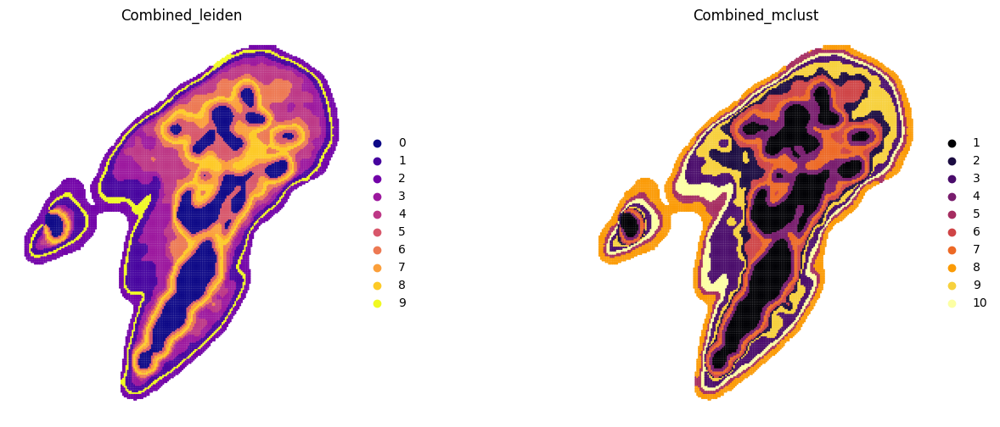

In [ ]:
####### Combined
sc.pp.neighbors(adata_RNA, use_rep='combine_recon')
res_RNA_ATAC = _priori_cluster(adata_RNA, eval_cluster_n = n_clusters)
sc.tl.leiden(adata_RNA, resolution = res_RNA_ATAC, key_added="Combined_leiden")
mclust_R(adata=adata_RNA, num_cluster = n_clusters, used_obsm="combine_recon", key_added="Combined_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["Combined_leiden", "Combined_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=65, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path, with the filename including the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_Combined_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

fitting ...
  |======================================================================| 100%


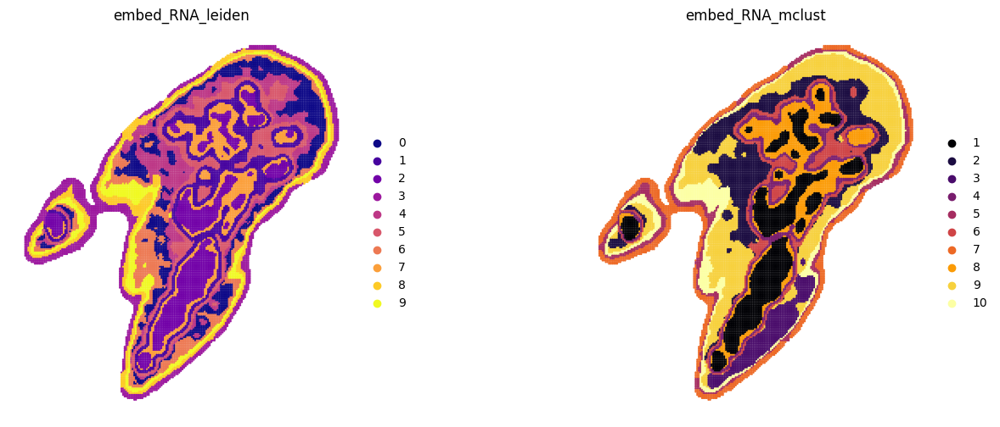

In [ ]:
####### RNA
sc.pp.neighbors(adata_RNA, use_rep=f"{methods}_embed")
res_RNA_ATAC = _priori_cluster(adata_RNA, eval_cluster_n = n_clusters)
sc.tl.leiden(adata_RNA, resolution = res_RNA_ATAC, key_added="embed_RNA_leiden")
mclust_R(adata=adata_RNA, num_cluster = n_clusters, used_obsm=f"{methods}_embed", key_added="embed_RNA_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["embed_RNA_leiden", "embed_RNA_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_RNA, color=color, palette=cmap, frameon=False, spot_size=65, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path, with the filename including the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_RNA_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

fitting ...
  |======================================================================| 100%


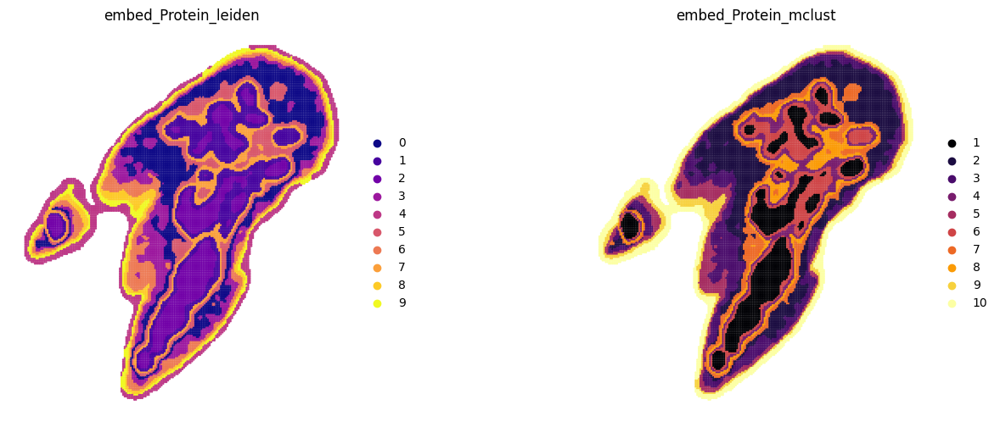

In [ ]:
###### Protein
sc.pp.neighbors(adata_Protein, use_rep=f"{methods}_embed")
res_RNA_ATAC = _priori_cluster(adata_Protein, eval_cluster_n=n_clusters)
sc.tl.leiden(adata_Protein, resolution=res_RNA_ATAC, key_added="embed_Protein_leiden")
mclust_R(adata=adata_Protein, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_Protein_mclust")

# Set the number and layout of subplots
n_panels = 2
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Color palette and color list
colors = ["embed_Protein_leiden", "embed_Protein_mclust"]
colormaps = ["plasma", "inferno"]  # Example color palettes, can be modified as needed

# Plot each panel
for ax, color, cmap in zip(axs, colors, colormaps):
    sc.pl.spatial(adata_Protein, color=color, palette=cmap, frameon=False, spot_size=65, ax=ax, show=False)
    ax.set_title(color)

# Save the figure to the specified path, with the filename including the timestamp, setting high resolution and removing excess margins
file_name = f"{data_name}_{methods}_Protein_spatial_{now}.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

In [ ]:
# # Create an AnnData object and assign observations and embeddings
# adata = anndata.AnnData(data_z)
# adata.obs = pd.concat([adata_RNA.obs, adata_Protein.obs])
# adata.obsm[f"{methods}_embed"] = data_z

# # Compute neighbors using the specified representation
# sc.pp.neighbors(adata, use_rep='X')

# # Perform UMAP for dimensionality reduction
# sc.tl.umap(adata)

# # Determine clustering resolution using a priori cluster function
# res_RNA_ATAC = _priori_cluster(adata, eval_cluster_n=n_clusters)

# # Perform Leiden clustering
# sc.tl.leiden(adata, resolution=res_RNA_ATAC, key_added="embed_leiden")

# # Apply Mclust for additional clustering analysis
# mclust_R(adata=adata, num_cluster=n_clusters, used_obsm=f"{methods}_embed", key_added="embed_mclust")

# # Set the number and layout of subplots
# n_panels = 3
# fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# # Define color schemes and lists
# colors = ['Omics', "embed_leiden", "embed_mclust"]
# colormaps = ["viridis", "plasma", "inferno"]  # Example color palettes, can be modified as needed

# # Generate UMAP plots for each color category
# for ax, color, cmap in zip(axs, colors, colormaps):
#     sc.pl.umap(adata, color=color, palette=cmap, ax=ax, show=False)
#     ax.set_title(color)

# # Save the figure to the specified path with filename including a timestamp
# # Save in high resolution and remove excess margins
# file_name = f"{data_name}_{methods}_embed_umap_{now}.pdf"
# file_path = os.path.join(save_path, file_name)
# fig.savefig(file_path, bbox_inches='tight', dpi=300)

# # Close the figure to free memory
# plt.close(fig)

In [ ]:
# adata_RNA.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_mRNA"]
# adata_Protein.obs["embed_leiden"] = adata.obs["embed_leiden"][adata.obs["Omics"] == data_name + "_Protein"]
# adata_RNA.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_mRNA"]
# adata_Protein.obs["embed_mclust"] = adata.obs["embed_mclust"][adata.obs["Omics"] == data_name + "_Protein"]

In [ ]:
####### Save Data
# adata.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_Protein_{now}.h5ad"),compression="gzip")
adata_RNA.write(os.path.join(save_path,f"{data_name}_{methods}_RNA_{now}.h5ad"),compression="gzip")
adata_Protein.write(os.path.join(save_path,f"{data_name}_{methods}_Protein_{now}.h5ad"),compression="gzip")

In [ ]:
save_path

'/home/project/11003054/changxu/Projects/SpaGNNs/Final_code/Results/A02677B5_bin50_Dirac/20240626143030'

In [ ]:
adata_RNA_bin50 = sc.read_h5ad(os.path.join(save_path, "A02677B5_bin50_Dirac_RNA_20240626143030.h5ad"))
adata_Protein_bin50 = sc.read_h5ad(os.path.join(save_path, "A02677B5_bin50_Dirac_Protein_20240626143030.h5ad"))

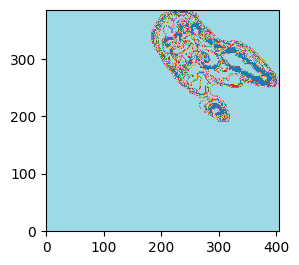

In [ ]:
adata_RNA_bin50.obs["Combined_leiden"] = "C_" + adata_RNA_bin50.obs["Combined_leiden"].astype(str)
adata_RNA_bin50.obs["Combined_leiden"] = adata_RNA_bin50.obs["Combined_leiden"].astype('category')
adata_RNA_bin50.uns["__type"] = 'UMI'

adata_RNA_bin50.obs["RNA_leiden"] = "R_" + adata_RNA_bin50.obs["embed_RNA_leiden"].astype(str)
adata_RNA_bin50.obs["Protein_leiden"] = "P_" + adata_Protein_bin50.obs["embed_Protein_leiden"].astype(str)

st.pl.spatial_domains(adata_RNA_bin50, bin_size=50, label_key="Combined_leiden", save_img=os.path.join(save_path, "spatial_domains.png"))

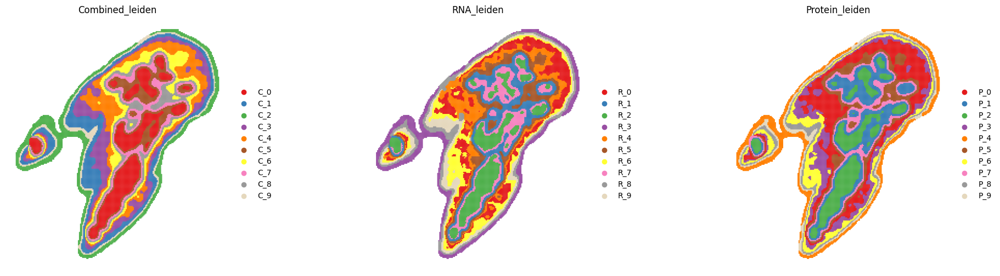

In [ ]:
# Define a custom color palette for the plots
colors_list = [
    "#E41A1C", "#377EB8", "#4DAF4A", "#984EA3", "#FF7F00", "#A65628", "#FFFF33", 
    "#F781BF", "#999999", "#E5D8BD", "#B3CDE3", "#CCEBC5", "#FED9A6", "#FBB4AE", 
    "#8DD3C7", "#BEBADA", "#80B1D3", "#B3DE69", "#FCCDE5", "#BC80BD", "#FFED6F", 
    "#8DA0CB", "#E78AC3", "#E5C494", "#CCCCCC", "#FB9A99", "#E31A1C", "#CAB2D6",
    "#6A3D9A", "#B15928"
]

# Set the number and layout of subplots
n_panels = 3
fig, axs = plt.subplots(1, n_panels, figsize=(8 * n_panels, 6))

# Define the clustering results to visualize
colors = ["Combined_leiden", "RNA_leiden", "Protein_leiden"]

# Generate spatial plots for each clustering result
for ax, color in zip(axs, colors):
    sc.pl.spatial(
        adata_RNA_bin50, 
        color=color, 
        palette=colors_list, 
        frameon=False, 
        spot_size=65, 
        ax=ax, 
        show=False
    )
    ax.set_title(color)

# Save the resulting figure to the specified path with a timestamped filename
file_name = f"{data_name}_{methods}_Combined_RNA_Protein_spatial.pdf"
file_path = os.path.join(save_path, file_name)
fig.savefig(file_path, bbox_inches='tight', dpi=300)

In [ ]:
adata_RNA_bin50.obsm['spatial_bin50'] = adata_RNA_bin50.obsm['spatial']//50

adata_RNA_bin50 = st.io.read_image(
    adata_RNA_bin50,
    filename=os.path.join(save_path, "spatial_domains.png"),
    img_layer="layer1",
    slice="slice1",
    scale_factor=1,
)

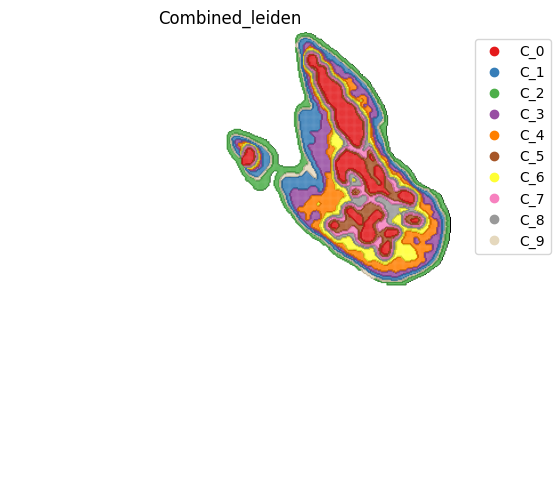

<Figure size 640x480 with 0 Axes>

In [ ]:
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA_bin50,
    space="spatial_bin50",
    color=["Combined_leiden"],
    alpha=0.8,
    figsize=(5, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    dpi=300, 
    pointsize=0.05,
    color_key = colors_list,
    ax=ax,
)
plt.tight_layout()
plt.show() 
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains.pdf"))

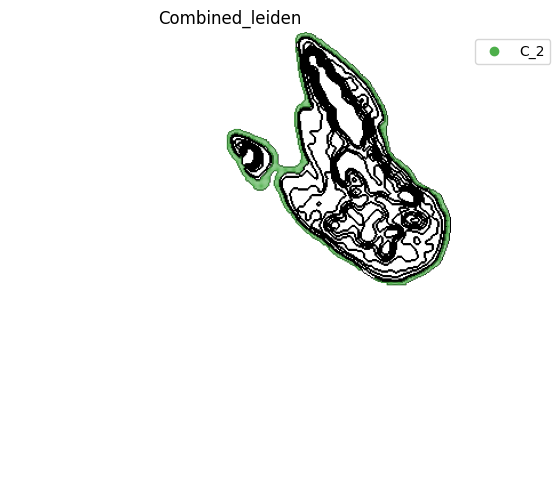

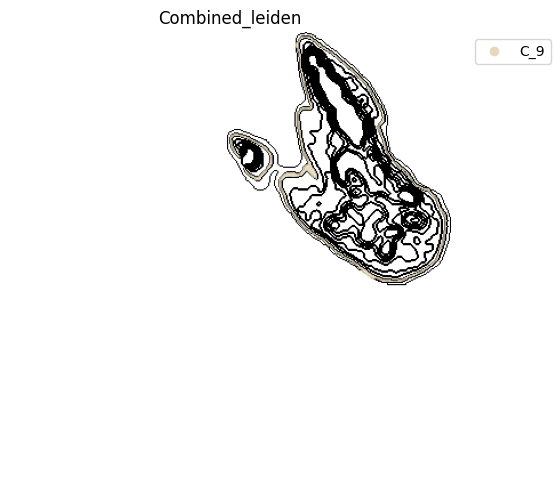

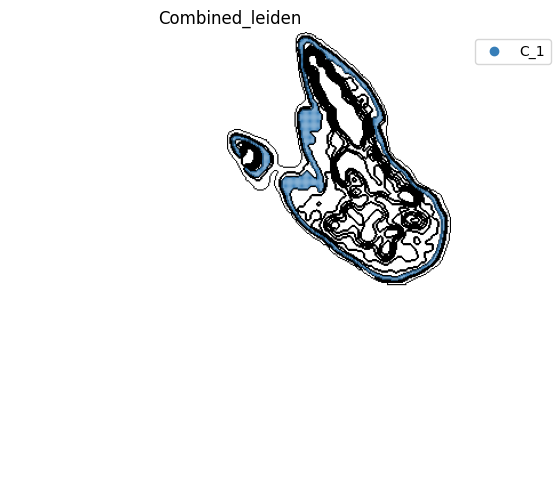

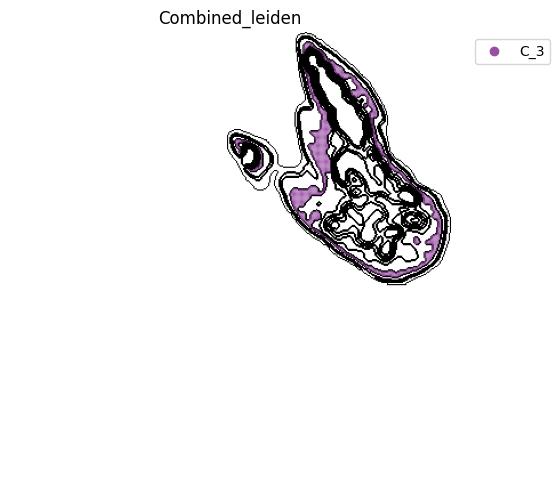

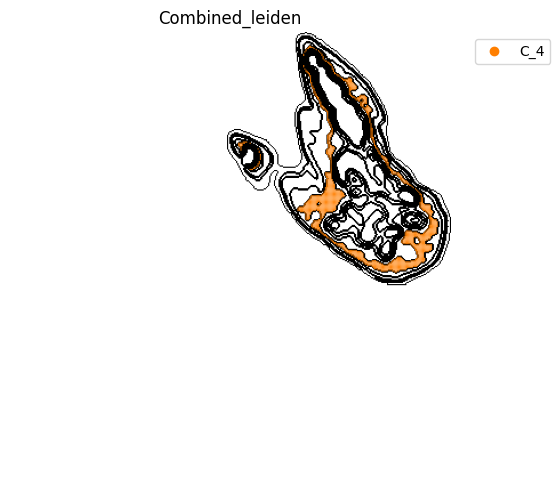

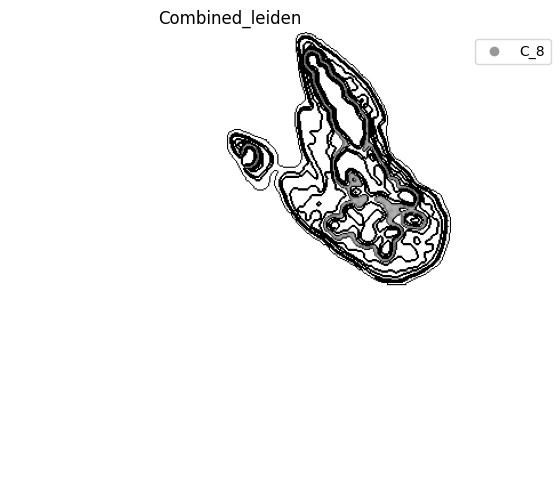

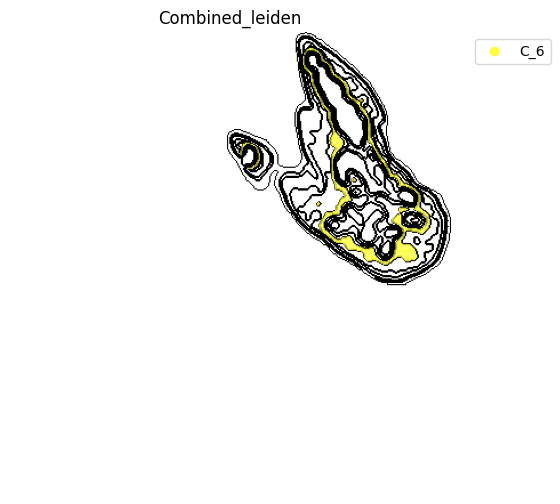

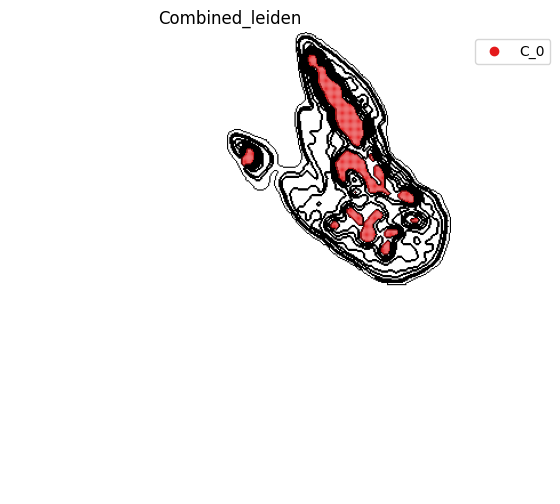

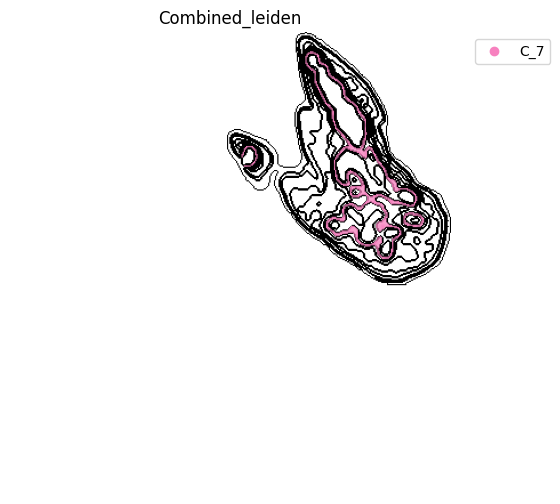

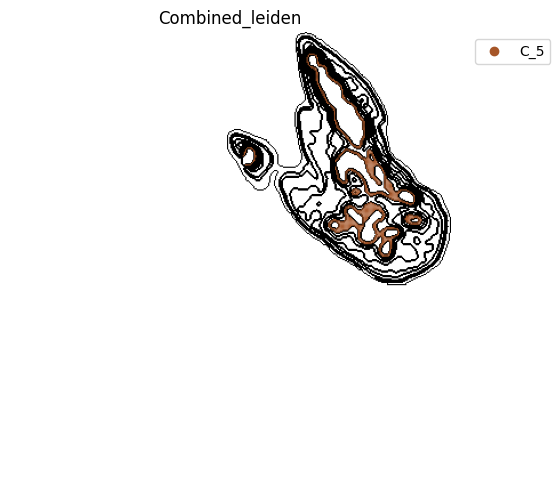

In [ ]:
for i in adata_RNA_bin50.obs['Combined_leiden'].unique():
    fig, ax = plt.subplots(figsize=(8, 6))
    st.pl.space(
    	adata_RNA_bin50[adata_RNA_bin50.obs['Combined_leiden'].isin([i]), :],
    	space="spatial_bin50",
    	color=['Combined_leiden'],
    	alpha=0.95,
    	pointsize=0.01,
    	figsize=(8, 6),
    	show_legend="upper left",
    	img_layers = "layer1",
    	slices="slice1",
    	color_key = adata_RNA_bin50.uns['Combined_leiden_colors'],
        ax=ax,
		)
    fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_{i}.png"), dpi = 900)##, bbox_inches='tight',

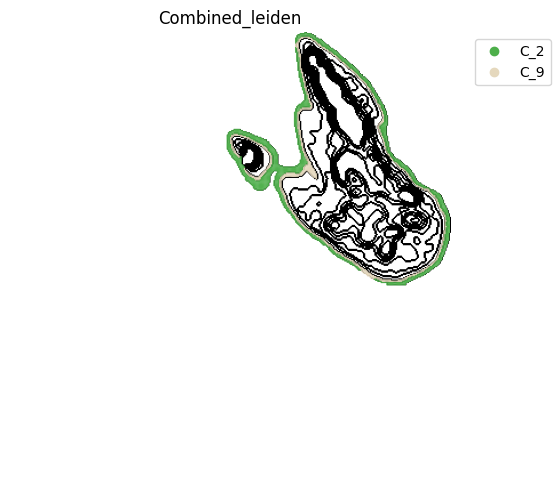

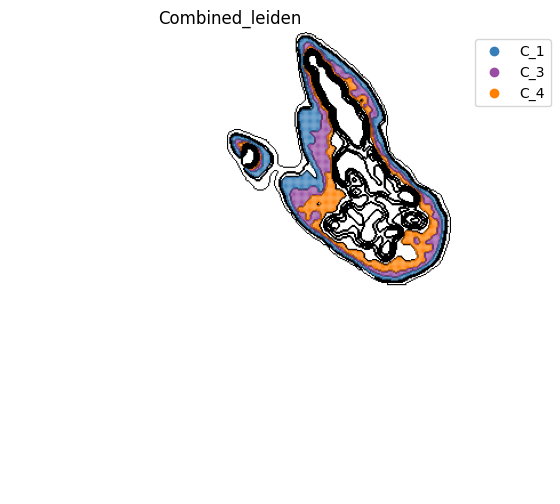

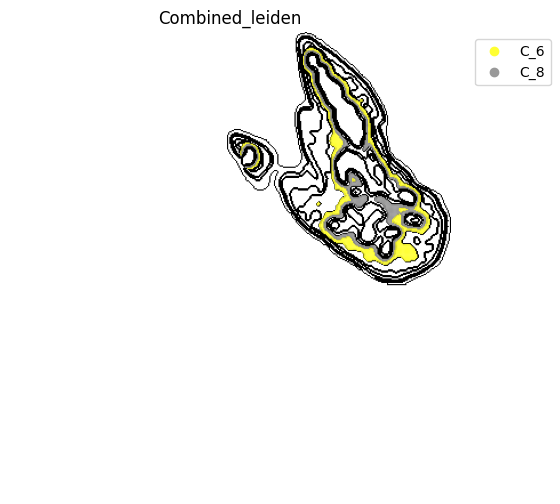

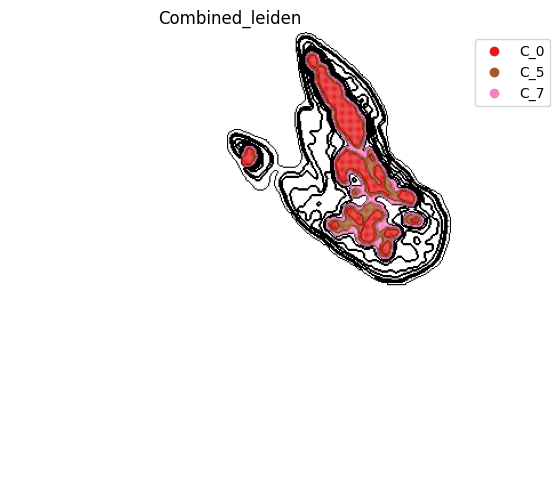

In [ ]:
Capsule_list = ["C_2", "C_9"]
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA_bin50[adata_RNA_bin50.obs['Combined_leiden'].isin(Capsule_list), :],
    space="spatial_bin50",
    color=['Combined_leiden'],
    alpha=0.95,
    pointsize=0.02,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA_bin50.uns['Combined_leiden_colors'],
    ax=ax,
	)
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Capsule.png"), dpi = 900)

Cortex_list = ["C_1", "C_3", "C_4"]
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA_bin50[adata_RNA_bin50.obs['Combined_leiden'].isin(Cortex_list), :],
    space="spatial_bin50",
    color=['Combined_leiden'],
    alpha=0.95,
    pointsize=0.02,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA_bin50.uns['Combined_leiden_colors'],
    ax=ax,
	)
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Cortex.png"), dpi = 900)


Cortex_Medullar_list = ["C_6", "C_8"]
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA_bin50[adata_RNA_bin50.obs['Combined_leiden'].isin(Cortex_Medullar_list), :],
    space="spatial_bin50",
    color=['Combined_leiden'],
    alpha=0.95,
    pointsize=0.02,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA_bin50.uns['Combined_leiden_colors'],
    ax=ax,
	)
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Cortex_Medullar.png"), dpi = 900)

Medullar_list = ["C_0", "C_5", "C_7"]
fig, ax = plt.subplots(figsize=(8, 6))
st.pl.space(
    adata_RNA_bin50[adata_RNA_bin50.obs['Combined_leiden'].isin(Medullar_list), :],
    space="spatial_bin50",
    color=['Combined_leiden'],
    alpha=0.95,
    pointsize=0.02,
    figsize=(4, 3),
    show_legend="upper left",
    img_layers = "layer1",
    slices="slice1",
    color_key = adata_RNA_bin50.uns['Combined_leiden_colors'],
    ax=ax,
	)
fig.savefig(os.path.join(save_path, f"{data_name}_{methods}_spatial_domains_Medullar.png"), dpi = 900)